In [1]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder
from scipy import stats
import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns
import sweetviz as sv
from statsmodels.tsa.stattools import acf, pacf
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
import statsmodels.api as sa
import sklearn.metrics 
from pandas.plotting import autocorrelation_plot
from pandas import read_csv
from pandas import DataFrame
from matplotlib import pyplot
from sklearn.metrics import mean_squared_error
%matplotlib inline
import numpy as np

import ydata_profiling as yp
from ydata_profiling import ProfileReport


In [2]:
data=pd.read_csv('processed.csv', index_col=0) 
data.head()

,Gender,Customer Type,Age,Type of Travel,Class,Flight Distance,Inflight wifi service,Departure/Arrival time convenient,Ease of Online booking,Gate location,...,Inflight entertainment,On-board service,Leg room service,Baggage handling,Checkin service,Inflight service,Cleanliness,Departure Delay in Minutes,Arrival Delay in Minutes,satisfaction
Customer ID,,,,,,,,,,,,,,,,,,,,,
70172,1,0,13,1,2,460,3.0,4.0,3.0,1.0,...,5.0,4.0,3.0,4.0,4.0,5.0,5.0,25,18.0,0
5047,1,1,25,0,0,235,3.0,2.0,3.0,3.0,...,1.0,1.0,5.0,3.0,1.0,4.0,1.0,1,6.0,0
110028,0,0,26,0,0,1142,2.0,2.0,2.0,2.0,...,5.0,4.0,3.0,4.0,4.0,4.0,5.0,0,0.0,1
24026,0,0,25,0,0,562,2.0,5.0,5.0,5.0,...,2.0,2.0,5.0,3.0,1.0,4.0,2.0,11,9.0,0
119299,1,0,61,0,0,214,3.0,3.0,3.0,3.0,...,3.0,3.0,4.0,4.0,3.0,3.0,3.0,0,0.0,1


In [6]:
#NOW WHEN DATASET IS READY WE PASS TO DATA INVESTIGATION TO CHOOSE METHOD OF MACHINE LEARNING

In [7]:
#for some categorical feature let's check unique values availble in that columns
for i in data.columns:
    if data[i].dtype=='object':
        print(i)
        print(data[i].unique(),"\n")
        
print('On-board service unique', data['On-board service'].unique(),"\n")
print('Inflight entertainment', data['Inflight entertainment'].unique(),"\n")
print('Seat comfort', data['Seat comfort'].unique(),"\n")
print('Baggage handling', data['Baggage handling'].unique(),"\n")
print('Food and drink', data['Food and drink'].unique(),"\n")
#We see that many columns have unique values to compare

On-board service unique [4.         1.         2.         3.         5.         3.38301624
 0.        ] 

Inflight entertainment [5.         1.         2.         3.         4.         3.35808001
 0.        ] 

Seat comfort [5.         1.         2.         3.         4.         3.44134926
 0.        ] 

Baggage handling [4.         3.         5.         1.         2.         3.63213169] 

Food and drink [5.         1.         2.         4.         3.20480462 3.
 0.        ] 



In [1]:
import warnings
warnings.filterwarnings('ignore')

#with sns.axes_style(style='ticks'):
#    g = sns.catplot("satisfaction", col="Gender", col_wrap=2, data=data, kind="count", height=2.5, aspect=1.0)  
#    g = sns.catplot("satisfaction", col="Customer Type", col_wrap=2, data=data, kind="count", height=2.5, aspect=1.0)
#    g = sns.catplot("satisfaction", col="Age", col_wrap=2, data=data, kind="count", height=2.5, aspect=1.0)  
#    g = sns.catplot("satisfaction", col="Type of Travel", col_wrap=2, data=data, kind="count", height=2.5, aspect=1.0)  
#    g = sns.catplot("satisfaction", col="Class", col_wrap=2, data=data, kind="count", height=2.5, aspect=1.0)  


In [9]:
#We can see that those who have personal travel and those who have business trip - almost equal level of not sutisfied,
# but quantity of satisfied business passengers visually about 90% higher than from personal trip
#Passengers older than 63 years and young from 9 to 22 are mostly not sutisfied,level of satisfaction raise from 22 years old
# though still there are more unpleased, and from 41 to 63 year we have much more sutisfied happy people
#Regarding gender - almost equal, women are not susisfied a little less still

<Axes: xlabel='satisfaction', ylabel='count'>

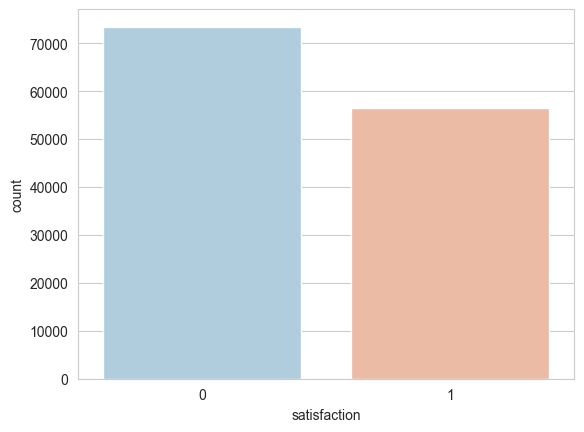

In [10]:
# Check satisfaction level totally now:
sns.set_style('whitegrid')
sns.countplot(x='satisfaction',data=data,palette='RdBu_r')
# See that level of not sutisfied passengers is higher, will check influence

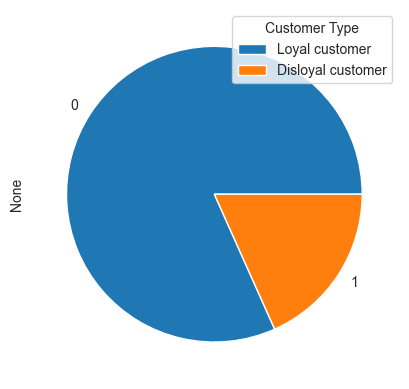

In [11]:
# Visulize ratio of loyal and not loyal passengers
grp=data.groupby("Customer Type")
grp.size().plot(kind='pie')
plt.legend(title="Customer Type", loc="upper right", labels=["Loyal customer", "Disloyal customer"])
plt.show()

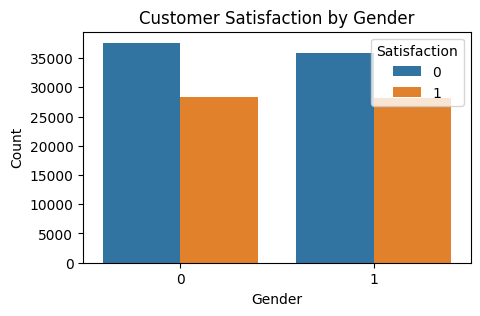

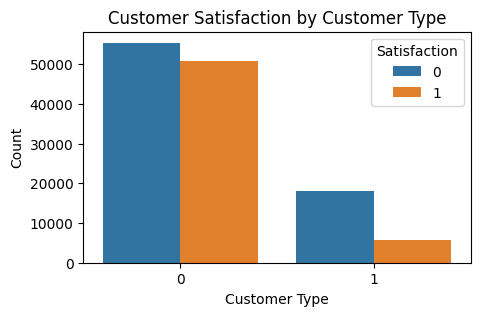

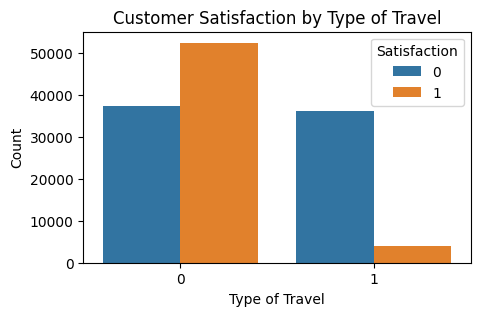

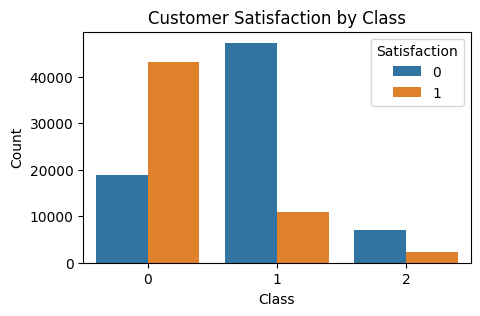

In [6]:
# Compare customer satisfaction across different categories
categorical_columns = ['Gender', 'Customer Type', 'Type of Travel', 'Class']

# Iterate through each categorical column
for col in categorical_columns:
    # Create a new figure with the specified size
    plt.figure(figsize=(5, 3))
    
    # Create a countplot to compare customer satisfaction by the current categorical column
    sns.countplot(data=data, x=col, hue='satisfaction')
    
    # Set the title of the plot
    plt.title('Customer Satisfaction by {}'.format(col))
    # Set the labels for x-axis and y-axis
    plt.xlabel(col)
    plt.ylabel('Count')
    
    # Add a legend for the satisfaction categories
    plt.legend(title='Satisfaction', loc='upper right')
    
    # Display the plot
    plt.show()    

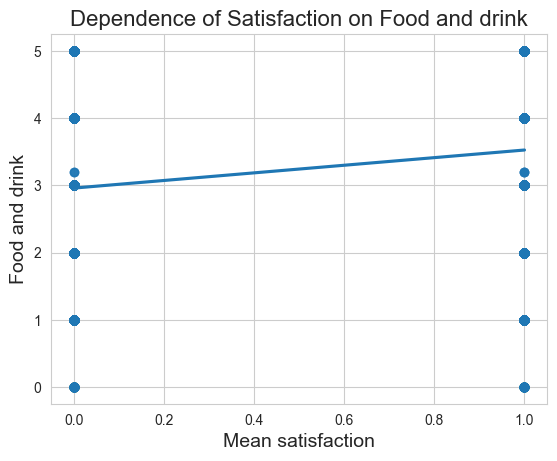

In [12]:
#Build a scatterplot of satisfaction depend on Food and drink provided:
sns.regplot(x=data ['satisfaction'], y=data['Food and drink'])
sns.set(rc={'figure.figsize':(30,15)})
plt.title(f'Dependence of Satisfaction on Food and drink', fontsize=16) 
plt.xlabel('Mean satisfaction', fontsize=14) 
plt.ylabel('Food and drink', fontsize=14) 

sns.set_style("ticks",{'axes.grid' : True})

Text(0, 0.5, 'Ease of Online booking')

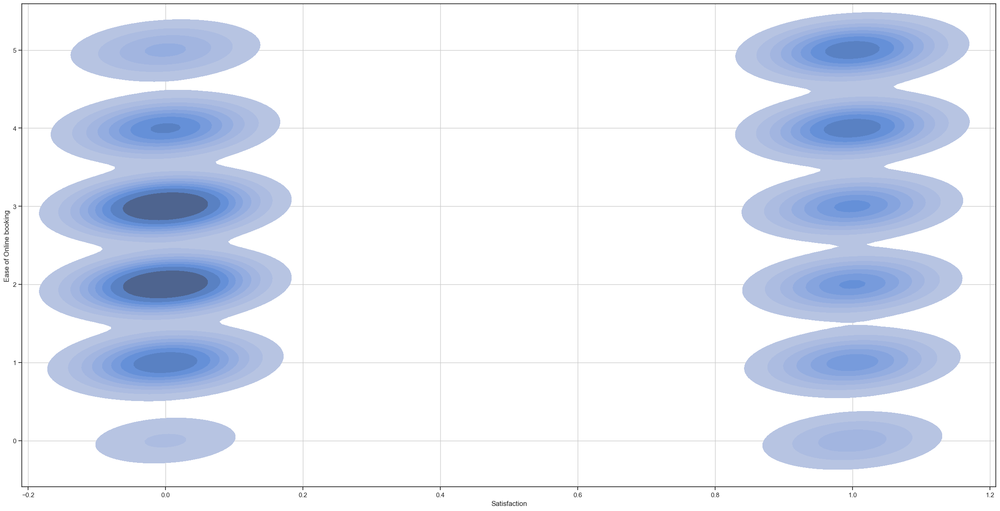

In [13]:
sns.kdeplot(x=data ['satisfaction'], y=data['Ease of Online booking'], fill=True)
plt.xlabel('Satisfaction')
plt.ylabel('Ease of Online booking')

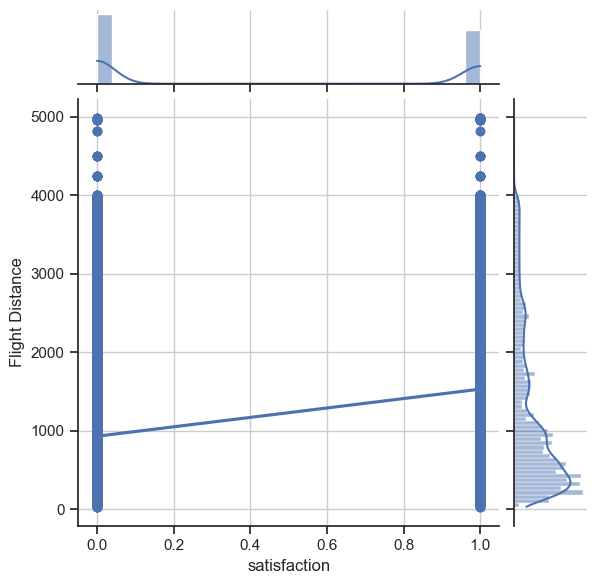

In [14]:
sns.jointplot(x=data ['satisfaction'], y=data ['Flight Distance'], data = data, kind = 'reg')

In [15]:
#sns.pairplot(data, hue='satisfaction', height=3, aspect=2)
#plt.show()

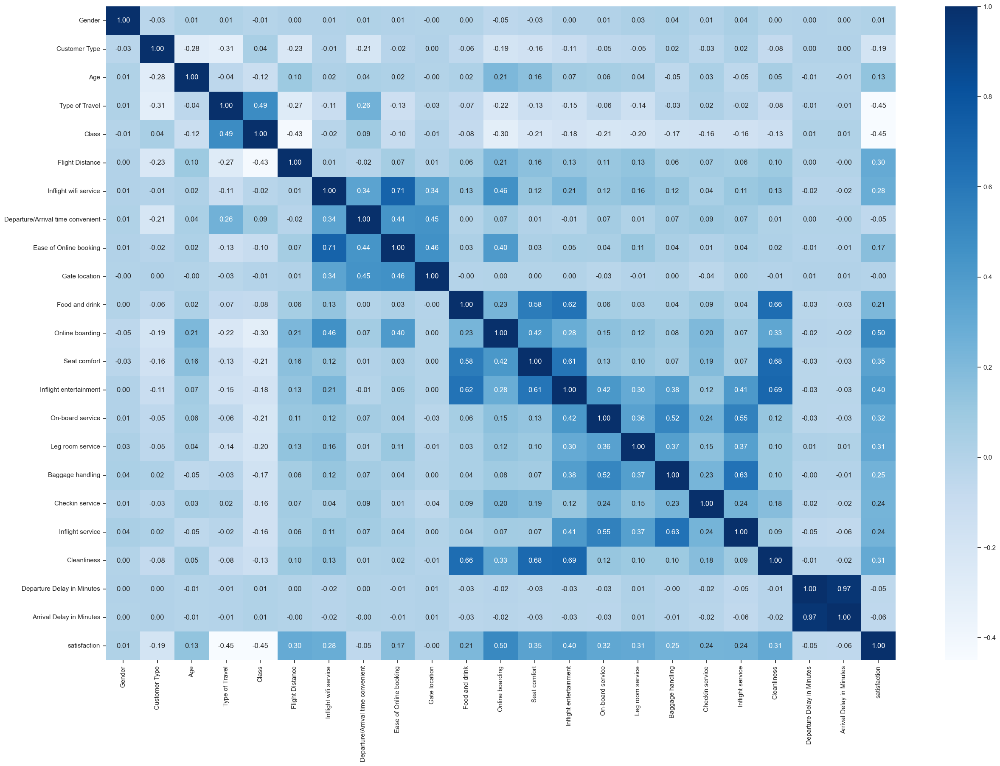

In [16]:
# we plot the correlation matrix
plt.figure(figsize=(30,20))
sns.heatmap(data.corr(), annot=True, fmt=".2f", cmap="Blues")
plt.show()

In [17]:
# Now make total analysis with sweetviz and ydata_profiling:

In [2]:
# !pip install sweetviz
#result=sv.analyze(data)
#result.show_notebook()

In [19]:
#pip install ydata-profiling
#import ydata_profiling as yp
#from ydata_profiling import ProfileReport
profile=ProfileReport(data)
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [20]:
# AS WE SEE THAT ALL DATA DETAILS ARE SIGNIFICANT, PASS CURRENT DATA FOR PRE-PROCESSING AND TRAIN

In [7]:
#data.to_csv('processed.csv') - saved already